# Calendar plots

### Purpose
We want an easy visulization tool to see how a unit of land changes within years, and to compare this across year. 

We envisage running this for relatively small ROIs, e.g. a single paddock, or a pasture-forest transition, or a small property. 

Make plots of RGB, NDVI or other in a grid of years by weeks (or 10-days?). 

The data should be resampled weekly and interpolated when missing obs. Also, fill in cloud masked pixels with interpolated values. 

Save calendar plot as tif or something with high enough resolution to blow it up as a full screen image.

Would also be useful to show time series of NDVI that indicates weeks with interpolated observations. 




In [1]:
%matplotlib inline

import os
import datacube
import numpy as np
import pandas as pd
import xarray as xr
import datetime as dt
import matplotlib.pyplot as plt

import sys
sys.path.insert(1, '../Tools/')
from dea_tools.temporal import xr_phenology, temporal_statistics
from dea_tools.datahandling import load_ard
from dea_tools.bandindices import calculate_indices
from dea_tools.plotting import display_map, rgb
from dea_tools.dask import create_local_dask_cluster

from dea_tools.plotting import display_map, rgb, xr_animation
import skimage

# Plot animation
from IPython.display import Image
from IPython.core.display import Video


import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)

# Create local dask cluster to improve data load time
client = create_local_dask_cluster(return_client=True)

2024-07-18 16:13:26,601 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 131415630336 due to system memory limit of 9.00 GiB


Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: /proxy/8787/status,
Dashboard: /proxy/8787/status,Workers: 1
Total threads: 2,Total memory: 9.00 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41071,Workers: 1
Dashboard: /proxy/8787/status,Total threads: 2
Started: Just now,Total memory: 9.00 GiB
Comm: tcp://127.0.0.1:38711,Total threads: 2
Dashboard: /proxy/37697/status,Memory: 9.00 GiB
Nanny: tcp://127.0.0.1:44021,


In [2]:
dc = datacube.Datacube(app='Vegetation_phenology')

In [9]:
# Define area of interest

# # 186 Milgadara Rd, Barwang NSW: -34.38904277303204, 148.46949938279096
# Yelkin -33.47904684379098, 146.3094839864518
# Boomahnoomoona -36.11965805095775, 146.08472404116773
# Adam O'tool site: -33.5040228817206, 148.6385170105664
# Grant Sims multispecies cover crop experiment sites -36.22746736927963, 144.40088864017818
# Spring Valley farm:-35.284243390317, 149.0074353022316
# crookwell site: -34.518782026305985, 149.55083805833056

#stub = 'CRKWL'
#stub = "SPRVAL"
stub = "MILGA"

lat=-34.38904
lon=148.46949
lon_buffer = 0.06
lat_buffer = 0.06

# Set the range of dates for the analysis
time_range = ('2020-01-01', '2023-01-01') # when is the earliest? 2016?

# Combine central lat,lon with buffer to get area of interest
lat_range = (lat-lat_buffer, lat+lat_buffer)
lon_range = (lon-lon_buffer, lon+lon_buffer)

display_map(x=lon_range, y=lat_range)


In [10]:
# Create a reusable query
query = {
    'y': lat_range,
    'x': lon_range,
    'time': time_range,
    'measurements': ['nbart_red', 'nbart_green', 'nbart_blue', 'nbart_nir_1'],
    'resolution': (-20, 20),
    'output_crs': 'epsg:6933',
    'group_by':'solar_day'
}

# Load available data from Sentinel-2
ds = load_ard(
    dc=dc,
    products=['ga_s2am_ard_3', 'ga_s2bm_ard_3'],
    cloud_mask='s2cloudless',
    min_gooddata=0.9,
    **query,
)

# Shut down Dask client now that we have loaded the data we need
client.close()

# Preview data
#ds


Finding datasets
    ga_s2am_ard_3
    ga_s2bm_ard_3
Counting good quality pixels for each time step using s2cloudless


/env/lib/python3.10/site-packages/rasterio/warp.py:344: NotGeoreferencedWarning: Dataset has no geotransform, gcps, or rpcs. The identity matrix will be returned.
  _reproject(


Filtering to 180 out of 476 time steps with at least 90.0% good quality pixels
Applying s2cloudless pixel quality/cloud mask
Loading 180 time steps


In [11]:
# Calculate the chosen vegetation proxy index and add it to the loaded data set
ds = calculate_indices(ds, index=['NDVI','NDWI'], collection='ga_s2_3')

In [41]:
# resample the data with an equal time interval, interpolate over missing intervals, and interpolate over missing values (e.g. cloud-masked)

ds_resamp = ds.resample(time="1W").interpolate("linear").interpolate_na(dim = 'time', method = 'linear')
num_frames = len(ds_resamp.time) # get total length from ds_weekly
print(num_frames)
ds_resamp

378


<xarray.Dataset>
Dimensions:      (y: 106, x: 98, time: 378)
Coordinates:
  * y            (y) float64 -4.147e+06 -4.147e+06 ... -4.149e+06 -4.149e+06
  * x            (x) float64 1.443e+07 1.443e+07 ... 1.443e+07 1.443e+07
    spatial_ref  int32 6933
  * time         (time) datetime64[ns] 2017-01-15 2017-01-22 ... 2024-04-07
Data variables:
    nbart_red    (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
    nbart_green  (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
    nbart_blue   (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
    nbart_nir_1  (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
    NDVI         (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
    NDWI         (time, y, x) float64 nan nan nan nan nan ... nan nan nan nan
Attributes:
    crs:           epsg:6933
    grid_mapping:  spatial_ref

In [17]:
path_out = '/home/jovyan/Projects/PaddockTS/Results/'


In [42]:
rgb(ds_resamp, 
    bands=['nbart_red', 'nbart_green', 'nbart_blue'], 
    robust = True, 
    size = 4,
    col="time", 
    #col_wrap=36,  # 10-day
    col_wrap=52, # weekly
    savefig_path = path_out+stub+'_calendar_plot.png')


Exporting image to /home/jovyan/Projects/PaddockTS/Results/CRKWL_calendar_plot.png


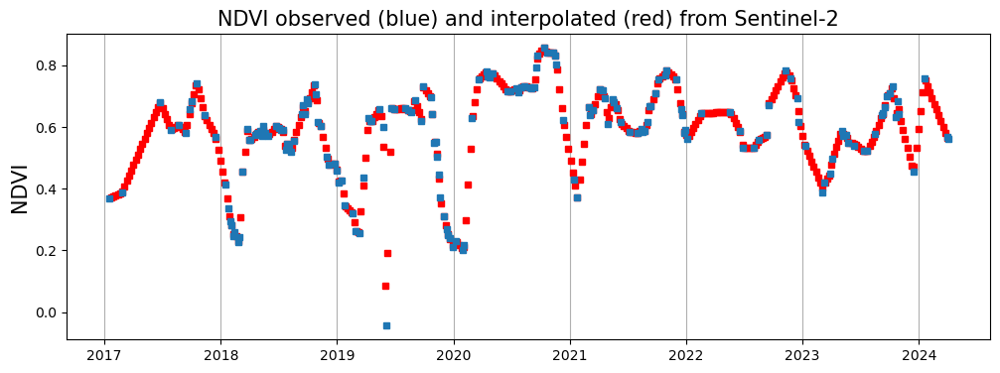

In [43]:
# interpolated
y1 = ds_resamp.NDVI.mean(['x', 'y']).values
x1 = ds_resamp.time.values

plt.figure(figsize=(12,4))

# plt.plot(x1, y1, color='r', linewidth=5, marker='o', markersize=10, markeredgecolor='k',
# markeredgewidth=2,linestyle='--',label='line 1')
plt.plot(x1, y1, 's', color='r', markersize=5)

# observed
y2 = ds.NDVI.mean(['x', 'y']).values
x2 = ds.time.values

plt.plot(x2, y2, 's', markersize=5)

plt.title("NDVI observed (blue) and interpolated (red) from Sentinel-2",fontsize=15)
plt.ylabel("NDVI",fontsize=15)

plt.grid(True, axis = 'x')

#plt.figure(figsize=(12,4))

#plt.show()

plt.savefig(path_out+stub+'_calendar_plot_ndvi_ts.png')

In [114]:
### Try padding the start so it begins in January. 

ds_resamp_pad = ds_resamp.pad(time = 8)

ds_resamp_pad = ds_resamp.pad(time = 8)


ds_resamp_pad

<xarray.Dataset>
Dimensions:      (y: 108, x: 98, time: 370)
Coordinates:
  * y            (y) float64 -4.039e+06 -4.039e+06 ... -4.041e+06 -4.041e+06
  * x            (x) float64 1.434e+07 1.434e+07 ... 1.434e+07 1.434e+07
    spatial_ref  int32 6933
  * time         (time) datetime64[ns] 2017-03-12 2017-03-19 ... 2024-04-07
Data variables:
    nbart_red    (time, y, x) float64 2.13e+03 2.189e+03 2.171e+03 ... nan nan
    nbart_green  (time, y, x) float64 1.402e+03 1.461e+03 1.466e+03 ... nan nan
    nbart_blue   (time, y, x) float64 936.8 987.6 1.001e+03 ... nan nan nan
    nbart_nir_1  (time, y, x) float64 2.88e+03 2.934e+03 2.907e+03 ... nan nan
    NDVI         (time, y, x) float64 0.1534 0.1476 0.1469 ... nan nan nan
    NDWI         (time, y, x) float64 -0.3467 -0.3365 -0.3306 ... nan nan nan
Attributes:
    crs:           epsg:6933
    grid_mapping:  spatial_ref

In [44]:
output = path_out+stub+'_test.mp4'


xr_animation(ds_resamp, 
             bands=['NDVI'], 
             output_path = output, 
             #show_gdf = gdf_, 
             #gdf_kwargs={"edgecolor": 'blue'},
             #gdf_kwargs={"edgecolor": pol['color_edge']}, # Make edge color something different
             show_text="NDVI",
             imshow_kwargs={"cmap": "Greens", "vmin": 0.0, "vmax": 1.0},
             #limit=10
            )

plt.close()
Video(output, embed=True)

Exporting animation to /home/jovyan/Projects/PaddockTS/Results/CRKWL_test.mp4


  0%|          | 0/378 (0.0 seconds remaining at ? frames/s)